Group 13 | Aditya Sharma, Adarsh Balan, Thaneshwar Prasad Sahu, Muhammad Ashraf Hussain, Prathyusha Thatipelli
Part B

In [29]:
import os
!git clone https://github.com/usuyama/pytorch-unet.git
%cd pytorch-unet

c:\Assignemnts\AAI\pytorch-unet


fatal: destination path 'pytorch-unet' already exists and is not an empty directory.


In [30]:
!dir

 Volume in drive C has no label.
 Volume Serial Number is AE81-DEB7

 Directory of c:\Assignemnts\AAI\pytorch-unet

07-11-2023  12:34    <DIR>          .
07-11-2023  12:34    <DIR>          ..
07-11-2023  11:57             1,307 .gitignore
26-11-2023  00:14        73,354,962 checkpoint.pth
07-11-2023  11:57             1,506 helper.py
07-11-2023  11:57    <DIR>          images
07-11-2023  11:57             1,091 LICENSE
07-11-2023  11:57               366 loss.py
07-11-2023  12:35    <DIR>          pytorch-unet
07-11-2023  11:57            36,678 pytorch_fcn.ipynb
07-11-2023  11:57            83,571 pytorch_resnet18_unet.ipynb
07-11-2023  11:57            67,145 pytorch_unet.ipynb
07-11-2023  11:57             1,756 pytorch_unet.py
07-11-2023  11:57           119,292 pytorch_unet_resnet18_colab.ipynb
07-11-2023  11:57            27,144 README.md
07-11-2023  11:57             3,489 simulation.py
07-11-2023  12:02    <DIR>          __pycache__
              12 File(s)     73,698,307 byte

In [31]:
img_width = 128
img_height = 128
img_channels = 6

In [32]:
#Train Dataset
import os
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import helper

# Specify the path to the folder containing your input images in TIFF format
input_folder_path = "C:/Assignemnts/AAI/pathologyData/pathologyData/train/input"

# Specify the path to the folder containing your mask images in PNG format
mask_folder_path = "C:/Assignemnts/AAI/pathologyData/pathologyData/train/mask"

# Initialize lists to store input and mask images
input_images = []
target_masks = []

# List all image files in the input and mask folders
input_image_files = [f for f in os.listdir(input_folder_path) if f.endswith(".tif")]
mask_image_files = [f for f in os.listdir(mask_folder_path) if f.endswith(".out.png")]

# Load input images
for input_filename in input_image_files:
    input_image_path = os.path.join(input_folder_path, input_filename)
    
    # Load images using Pillow (PIL) and resize them to a common shape
    image = Image.open(input_image_path)
    image = image.resize((img_width, img_height))  # Replace 'width' and 'height' with the desired dimensions
    input_image = np.array(image)
    
    input_images.append(input_image)

input_images = np.array(input_images)

# Load mask images and manually add channels
for mask_filename in mask_image_files:
    mask_image_path = os.path.join(mask_folder_path, mask_filename)
    
    # Load images using Pillow (PIL) and convert them to grayscale
    image = Image.open(mask_image_path).convert('L')  # 'L' mode represents grayscale
    image = image.resize((img_width, img_height))  # Resize as needed
    mask_image = np.array(image)

    # Create a new NumPy array to store the multi-channel mask image
    multi_channel_mask = np.zeros((mask_image.shape[0], mask_image.shape[1], 3), dtype=np.uint8)

    # Add each channel of the original mask image to the new NumPy array
    multi_channel_mask[:, :, 0] = mask_image  # Red channel
    multi_channel_mask[:, :, 1] = mask_image  # Green channel
    multi_channel_mask[:, :, 2] = mask_image  # Blue channel

    # Add the multi-channel mask image to the target_masks list
    target_masks.append(multi_channel_mask)

target_masks_original = np.array(target_masks)

# Reshape target_masks to (60, 3, 128, 128)
target_masks = target_masks_original.transpose(0, 3, 1, 2)

print("Number of input images:", len(input_images))
print("Number of mask images:", len(target_masks))
print("input_images shape and range", input_images.shape, input_images.min(), input_images.max())
print("target_masks shape and range", target_masks.shape, target_masks.min(), target_masks.max())

def masks_to_colorimg(masks):
    """Colorizes mask images with 3 channels.

    Args:
        masks: A NumPy array of shape (batch_size, height, width, 3) representing masks with
               three channels per pixel.

    Returns:
        A NumPy array of shape (batch_size, height, width, 3) containing colorized mask images.
    """

    return masks


#Map each channel (i.e. class) to each color
target_masks_rgb = [masks_to_colorimg(x) for x in target_masks_original]

Number of input images: 60
Number of mask images: 60
input_images shape and range (60, 128, 128, 3) 0 255
target_masks shape and range (60, 3, 128, 128) 0 255


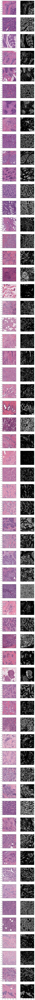

In [33]:
helper.plot_side_by_side([input_images, target_masks_rgb])

In [34]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

class CustomDataset(Dataset):
    def __init__(self, input_images, target_masks, transform=None):
        self.input_images = input_images
        self.target_masks = target_masks
        self.transform = transform

    def __len__(self):
        return len(self.input_images)

    def __getitem__(self, idx):
        image = self.input_images[idx]
        mask = self.target_masks[idx]

        if self.transform:
            image = self.transform(image)

        return [image, mask]

# Define transformations if needed
trans = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])  # Adjust normalization as needed
])

# Create instances of your custom dataset
custom_train_set = CustomDataset(input_images, target_masks, transform=trans)
custom_val_set = CustomDataset(input_images, target_masks, transform=trans)

# Define batch size
batch_size = 25

# Create data loaders
custom_dataloaders = {
    'train': DataLoader(custom_train_set, batch_size=batch_size, shuffle=True, num_workers=0),
    'val': DataLoader(custom_val_set, batch_size=batch_size, shuffle=True, num_workers=0)
}


torch.Size([25, 3, 128, 128]) torch.Size([25, 3, 128, 128])


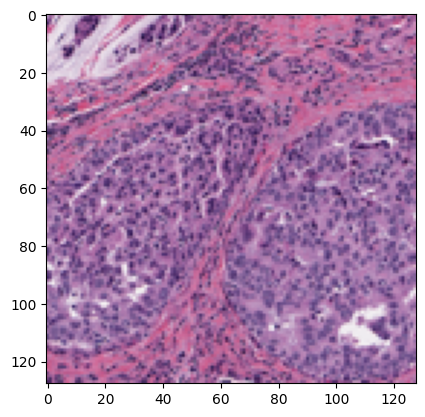

In [35]:
import torchvision.utils

def reverse_transform(inp):
  inp = inp.numpy().transpose((1, 2, 0))
  mean = np.array([0.485, 0.456, 0.406])
  std = np.array([0.229, 0.224, 0.225])
  inp = std * inp + mean
  inp = np.clip(inp, 0, 1)
  inp = (inp * 255).astype(np.uint8)

  return inp

# Get a batch of training data
inputs, masks = next(iter(custom_dataloaders['train']))

print(inputs.shape, masks.shape)

plt.imshow(reverse_transform(inputs[3]))

In [36]:
import torch.nn as nn
import torchvision.models


def convrelu(in_channels, out_channels, kernel, padding):
  return nn.Sequential(
    nn.Conv2d(in_channels, out_channels, kernel, padding=padding),
    nn.ReLU(inplace=True),
  )


class ResNetUNet(nn.Module):
  def __init__(self, n_class):
    super().__init__()

    self.base_model = torchvision.models.resnet18(pretrained=True)
    self.base_layers = list(self.base_model.children())

    self.layer0 = nn.Sequential(*self.base_layers[:3]) # size=(N, 64, x.H/2, x.W/2)
    self.layer0_1x1 = convrelu(64, 64, 1, 0)
    self.layer1 = nn.Sequential(*self.base_layers[3:5]) # size=(N, 64, x.H/4, x.W/4)
    self.layer1_1x1 = convrelu(64, 64, 1, 0)
    self.layer2 = self.base_layers[5]  # size=(N, 128, x.H/8, x.W/8)
    self.layer2_1x1 = convrelu(128, 128, 1, 0)
    self.layer3 = self.base_layers[6]  # size=(N, 256, x.H/16, x.W/16)
    self.layer3_1x1 = convrelu(256, 256, 1, 0)
    self.layer4 = self.base_layers[7]  # size=(N, 512, x.H/32, x.W/32)
    self.layer4_1x1 = convrelu(512, 512, 1, 0)

    self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

    self.conv_up3 = convrelu(256 + 512, 512, 3, 1)
    self.conv_up2 = convrelu(128 + 512, 256, 3, 1)
    self.conv_up1 = convrelu(64 + 256, 256, 3, 1)
    self.conv_up0 = convrelu(64 + 256, 128, 3, 1)

    self.conv_original_size0 = convrelu(3, 64, 3, 1)
    self.conv_original_size1 = convrelu(64, 64, 3, 1)
    self.conv_original_size2 = convrelu(64 + 128, 64, 3, 1)

    self.conv_last = nn.Conv2d(64, n_class, 1)

  def forward(self, input):
    x_original = self.conv_original_size0(input)
    x_original = self.conv_original_size1(x_original)

    layer0 = self.layer0(input)
    layer1 = self.layer1(layer0)
    layer2 = self.layer2(layer1)
    layer3 = self.layer3(layer2)
    layer4 = self.layer4(layer3)

    layer4 = self.layer4_1x1(layer4)
    x = self.upsample(layer4)
    layer3 = self.layer3_1x1(layer3)
    x = torch.cat([x, layer3], dim=1)
    x = self.conv_up3(x)

    x = self.upsample(x)
    layer2 = self.layer2_1x1(layer2)
    x = torch.cat([x, layer2], dim=1)
    x = self.conv_up2(x)

    x = self.upsample(x)
    layer1 = self.layer1_1x1(layer1)
    x = torch.cat([x, layer1], dim=1)
    x = self.conv_up1(x)

    x = self.upsample(x)
    layer0 = self.layer0_1x1(layer0)
    x = torch.cat([x, layer0], dim=1)
    x = self.conv_up0(x)

    x = self.upsample(x)
    x = torch.cat([x, x_original], dim=1)
    x = self.conv_original_size2(x)

    out = self.conv_last(x)

    return out

In [37]:
import torch
import torch.nn as nn
import pytorch_unet

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('device', device)

model = ResNetUNet(6)
model = model.to(device)

device cpu


c:\Users\31687\AppData\Local\Programs\Python\Python39\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\31687\AppData\Local\Programs\Python\Python39\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [38]:
model

ResNetUNet(
  (base_model): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tra

In [39]:
import torchsummary
from torchsummary import summary
summary(model, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
              ReLU-2         [-1, 64, 224, 224]               0
            Conv2d-3         [-1, 64, 224, 224]          36,928
              ReLU-4         [-1, 64, 224, 224]               0
            Conv2d-5         [-1, 64, 112, 112]           9,408
            Conv2d-6         [-1, 64, 112, 112]           9,408
       BatchNorm2d-7         [-1, 64, 112, 112]             128
       BatchNorm2d-8         [-1, 64, 112, 112]             128
              ReLU-9         [-1, 64, 112, 112]               0
             ReLU-10         [-1, 64, 112, 112]               0
        MaxPool2d-11           [-1, 64, 56, 56]               0
        MaxPool2d-12           [-1, 64, 56, 56]               0
           Conv2d-13           [-1, 64, 56, 56]          36,864
           Conv2d-14           [-1, 64,

In [40]:
from collections import defaultdict
import torch.nn.functional as F
from loss import dice_loss
#https://pycad.co/the-difference-between-dice-and-dice-loss/

checkpoint_path = "checkpoint.pth"

def calc_loss(pred, target, metrics, bce_weight=0.5):
    pred = pred.to(torch.float)
    target = target.to(torch.float)
        
    bce = F.binary_cross_entropy_with_logits(pred, target)

    pred = torch.sigmoid(pred)
    dice = dice_loss(pred, target)

    loss = bce * bce_weight + dice * (1 - bce_weight)

    metrics['bce'] += bce.data.cpu().numpy() * target.size(0)
    metrics['dice'] += dice.data.cpu().numpy() * target.size(0)
    metrics['loss'] += loss.data.cpu().numpy() * target.size(0)

    return loss

def print_metrics(metrics, epoch_samples, phase):
    outputs = []
    for k in metrics.keys():
        outputs.append("{}: {:4f}".format(k, metrics[k] / epoch_samples))

    print("{}: {}".format(phase, ", ".join(outputs)))

def train_model(model, optimizer, scheduler, num_epochs=25):
    best_loss = 1e10

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        since = time.time()

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            metrics = defaultdict(float)
            epoch_samples = 0

            for inputs, labels in custom_dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)
                
                # Ensure that inputs and labels have the same data type (e.g., torch.float)
                inputs = inputs.to(torch.float)
                labels = labels.to(torch.float)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = calc_loss(outputs, labels, metrics)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                epoch_samples += inputs.size(0)

            print_metrics(metrics, epoch_samples, phase)
            epoch_loss = metrics['loss'] / epoch_samples

            if phase == 'train':
              scheduler.step()
              for param_group in optimizer.param_groups:
                  print("LR", param_group['lr'])

            # save the model weights
            if phase == 'val' and epoch_loss < best_loss:
                print(f"saving best model to {checkpoint_path}")
                best_loss = epoch_loss
                torch.save(model.state_dict(), checkpoint_path)

        time_elapsed = time.time() - since
        print('{:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))

    print('Best val loss: {:4f}'.format(best_loss))

    # load best model weights
    model.load_state_dict(torch.load(checkpoint_path))
    return model


In [61]:
#Fine Tuning the model
import torch
import torch.optim as optim
from torch.optim import lr_scheduler
import time

num_class = 3
model = ResNetUNet(num_class).to(device)

# freeze backbone layers
for l in model.base_layers:
  for param in l.parameters():
    param.requires_grad = False

optimizer_ft = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-6, weight_decay=0.001)

#Decays the learning rate of each parameter group by gamma every step_size epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.85)

model = train_model(model, optimizer_ft, exp_lr_scheduler, num_epochs=5)

Epoch 0/4
----------
train: bce: 0.415276, dice: 0.010455, loss: 0.212865
LR 1e-06
val: bce: 0.418885, dice: 0.010474, loss: 0.214679
saving best model to checkpoint.pth
0m 22s
Epoch 1/4
----------
train: bce: 0.360146, dice: 0.009912, loss: 0.185029
LR 1e-06
val: bce: 0.374856, dice: 0.010040, loss: 0.192448
saving best model to checkpoint.pth
0m 24s
Epoch 2/4
----------
train: bce: 0.305694, dice: 0.009395, loss: 0.157544
LR 1e-06
val: bce: 0.321751, dice: 0.009521, loss: 0.165636
saving best model to checkpoint.pth
0m 24s
Epoch 3/4
----------
train: bce: 0.252940, dice: 0.008870, loss: 0.130905
LR 1e-06
val: bce: 0.266092, dice: 0.008974, loss: 0.137533
saving best model to checkpoint.pth
0m 23s
Epoch 4/4
----------
train: bce: 0.199874, dice: 0.008351, loss: 0.104112
LR 1e-06
val: bce: 0.203664, dice: 0.008363, loss: 0.106013
saving best model to checkpoint.pth
0m 23s
Best val loss: 0.106013


In [62]:
#Test Dataset
import os
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import helper

# Specify the path to the folder containing your input images in TIFF format
test_input_folder_path = "C:/Assignemnts/AAI/pathologyData/pathologyData/test/input"

# Specify the path to the folder containing your mask images in PNG format
test_mask_folder_path = "C:/Assignemnts/AAI/pathologyData/pathologyData/test/mask"

# Initialize lists to store input and mask images
test_input_images = []
test_target_masks = []

# List all image files in the input and mask folders
test_input_image_files = [f for f in os.listdir(test_input_folder_path) if f.endswith(".tif")]
test_mask_image_files = [f for f in os.listdir(test_mask_folder_path) if f.endswith(".out.png")]

# Load input images
for input_filename in test_input_image_files:
    input_image_path = os.path.join(test_input_folder_path, input_filename)
    
    # Load images using Pillow (PIL) and resize them to a common shape
    image = Image.open(input_image_path)
    image = image.resize((img_width, img_height))  # Replace 'width' and 'height' with the desired dimensions
    input_image = np.array(image)
    
    test_input_images.append(input_image)

test_input_images = np.array(test_input_images)

# Load mask images and manually add channels
for mask_filename in test_mask_image_files:
    mask_image_path = os.path.join(test_mask_folder_path, mask_filename)
    
    # Load images using Pillow (PIL) and convert them to grayscale
    image = Image.open(mask_image_path).convert('L')  # 'L' mode represents grayscale
    image = image.resize((img_width, img_height))  # Resize as needed
    mask_image = np.array(image)
    
    # Create a new NumPy array to store the multi-channel mask image
    multi_channel_mask = np.zeros((mask_image.shape[0], mask_image.shape[1], 3), dtype=np.uint8)

    # Add each channel of the original mask image to the new NumPy array
    multi_channel_mask[:, :, 0] = mask_image  # Red channel
    multi_channel_mask[:, :, 1] = mask_image  # Green channel
    multi_channel_mask[:, :, 2] = mask_image  # Blue channel

    # Add the multi-channel mask image to the target_masks list
    test_target_masks.append(multi_channel_mask)

test_target_masks_original = np.array(test_target_masks)

#Reshape target_masks to (60, 3, 128, 128)
test_target_masks = test_target_masks_original.transpose(0, 3, 1, 2)

print("Number of test input images:", len(test_input_images))
print("Number of test mask images:", len(test_target_masks))
print("test_input_images shape and range", test_input_images.shape, test_input_images.min(), test_input_images.max())
print("test_target_masks shape and range", test_target_masks.shape, test_target_masks.min(), test_target_masks.max())
print("test_target_masks_original shape and range", test_target_masks_original.shape, test_target_masks_original.min(), test_target_masks_original.max())

def masks_to_colorimg(masks):
    """Colorizes mask images with 3 channels.

    Args:
        masks: A NumPy array of shape (batch_size, height, width, 3) representing masks with
               three channels per pixel.

    Returns:
        A NumPy array of shape (batch_size, height, width, 3) containing colorized mask images.
    """

    return masks


#Map each channel (i.e. class) to each color
test_target_masks_rgb = [masks_to_colorimg(x) for x in test_target_masks_original]

Number of test input images: 24
Number of test mask images: 24
test_input_images shape and range (24, 128, 128, 3) 0 255
test_target_masks shape and range (24, 3, 128, 128) 0 255
test_target_masks_original shape and range (24, 128, 128, 3) 0 255


In [63]:
import numpy as np
import matplotlib.pyplot as plt
# Set the print options for NumPy to show more decimal places
np.set_printoptions(precision=4, suppress=True)

custom_test_dataset = CustomDataset(test_input_images, test_target_masks_original, transform=trans)
test_loader = DataLoader(custom_test_dataset, batch_size=3, shuffle=False, num_workers=0)

# Get the first batch
inputs, labels = next(iter(test_loader))
inputs = inputs.to(device)
labels = labels.to(device)

print('labels.shape', labels.numpy().shape)
print('inputs.shape', inputs.shape)
# Predict
pred_original = model(inputs)
print(pred_original.shape)
# pred = torch.sigmoid(pred)
pred = pred_original.data.cpu().numpy()
# pred_test = np.transpose(pred.data.cpu().numpy(), (0, 2, 3, 1))
print(pred.shape)
print(pred)

# Change channel-order and make 3 channels for matplot
test_input_images_rgb = [reverse_transform(x) for x in inputs.cpu()]

def masks_to_colorimg(masks):
    """Colorizes mask images with 3 channels.

    Args:
        masks: A NumPy array of shape (batch_size, height, width, 3) representing masks with
               three channels per pixel.

    Returns:
        A NumPy array of shape (batch_size, height, width, 3) containing colorized mask images.
    """

    return masks

# Map each channel (i.e. class) to each color
test_target_masks_rgb = [masks_to_colorimg(x) for x in labels.cpu().numpy()]
pred_mask = [masks_to_colorimg(x) for x in pred]


labels.shape (3, 128, 128, 3)
inputs.shape torch.Size([3, 3, 128, 128])
torch.Size([3, 3, 128, 128])
(3, 3, 128, 128)
[[[[-0.1049 -0.1106 -0.1112 ... -0.0996 -0.1055 -0.0966]
   [-0.1146 -0.1141 -0.1106 ... -0.098  -0.1121 -0.1009]
   [-0.1084 -0.1308 -0.124  ... -0.1149 -0.0974 -0.1057]
   ...
   [-0.1237 -0.1032 -0.1138 ... -0.1018 -0.0964 -0.1048]
   [-0.114  -0.1337 -0.1122 ... -0.1002 -0.0937 -0.1132]
   [-0.097  -0.1118 -0.1271 ... -0.1136 -0.1134 -0.108 ]]

  [[ 0.0239  0.0273  0.0201 ...  0.0208  0.024   0.0178]
   [ 0.0303  0.0371  0.0365 ...  0.039   0.0225  0.0254]
   [ 0.0307  0.0372  0.0395 ...  0.0215  0.0355  0.0243]
   ...
   [ 0.0386  0.0444  0.0486 ...  0.0278  0.0334  0.0368]
   [ 0.0285  0.0542  0.0557 ...  0.0374  0.0442  0.0296]
   [ 0.0404  0.0384  0.047  ...  0.0452  0.0345  0.0318]]

  [[ 0.1066  0.0933  0.0912 ...  0.0997  0.0975  0.097 ]
   [ 0.1023  0.0938  0.0983 ...  0.0872  0.0887  0.0988]
   [ 0.1007  0.089   0.0932 ...  0.083   0.1089  0.1067]
   ...
  

In [64]:
import torch

def apply_sigmoid_and_threshold(pred, threshold=0.5):
    # Apply sigmoid to scale the output to [0, 1]
    pred_sigmoid = torch.sigmoid(pred)
    
    # Apply threshold to get binary mask
    pred_binary = (pred_sigmoid > threshold).float()
    
    return pred_binary

# Apply sigmoid and threshold to the predictions
predicted_masks = [apply_sigmoid_and_threshold(p) for p in pred_original]

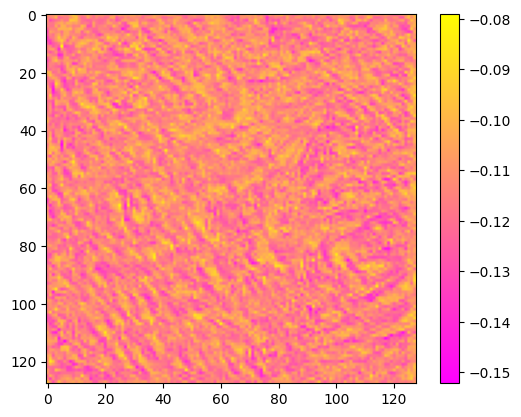

In [65]:
plt.imshow(pred[0, 0, :, :], cmap='spring')
plt.colorbar()
plt.show()

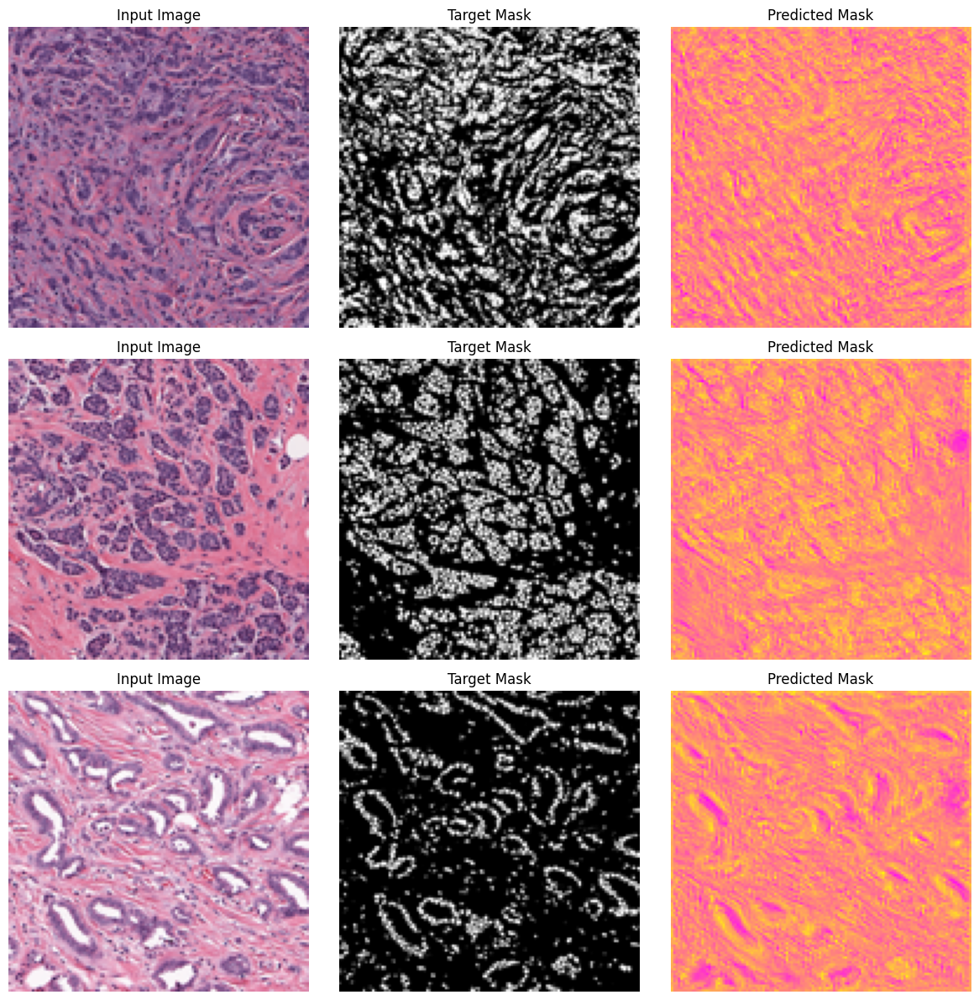

In [75]:
# Assuming the first channel can represent the mask
# Adjust the channel index if needed

# Create a figure with subplots
num_images = 3
fig, axes = plt.subplots(num_images, 3, figsize=(12, num_images * 4))

for i in range(num_images):
    # Plot the input image
    axes[i, 0].imshow(test_input_images_rgb[i])
    axes[i, 0].set_title('Input Image')
    axes[i, 0].axis('off')

    # Plot the target mask
    axes[i, 1].imshow(test_target_masks_rgb[i], cmap='gray')
    axes[i, 1].set_title('Target Mask')
    axes[i, 1].axis('off')

    # Plot the predicted mask (first channel)
    axes[i, 2].imshow(pred[i][0], cmap='spring')  # Adjust channel index if needed
    axes[i, 2].set_title('Predicted Mask')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

In [82]:
import numpy as np

def dice_coefficient(y_true, y_pred):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1e-6) / (np.sum(y_true_f) + np.sum(y_pred_f) + 1e-6)

def iou(y_true, y_pred):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    union = np.sum(y_true_f) + np.sum(y_pred_f) - intersection
    return (intersection + 1e-6) / (union + 1e-6)

# Example usage:
# Assuming `predicted_masks` are your model's output masks
# and `test_target_masks` are your ground truth masks
# Make sure these are binary masks (0 and 1)

# Convert lists of arrays to single numpy arrays
predicted_masks_array = np.stack(pred)
test_target_masks_array = np.stack(test_target_masks_rgb)

# Now calculate the metrics
dice_score = dice_coefficient(test_target_masks_array, predicted_masks_array)
iou_score = iou(test_target_masks_array, predicted_masks_array)

print(f"Dice Coefficient: {dice_score}")
print(f"IoU: {iou_score}")

Dice Coefficient: 0.0083891469825516
IoU: 0.004212242050170816


The Dice Coefficient and IoU values you obtained are quite low, indicating a limited overlap between the predicted masks and the ground truth masks

For image segmentation tasks, especially in medical imaging, metrics like the Dice Coefficient and Intersection over Union (IoU) are indeed often more informative than accuracy. These metrics are particularly useful for evaluating the performance of models in tasks where the classes are imbalanced, such as in our case with pathology images.